# Регрессионный анализ

##  Введение

Данный notebook представляет собой процесс прогнозирования непрерывной переменной с помощью методов машинного обучения. В частности, мы хотим прогнозировать цены на жилье на основе нескольких признаков с использованием регрессионного анализа. В качестве примера будем использовать набор данных о продажах домов (с мая 2014 г. по май 2015 г.) в Сиэтле (округ Кинг), для обучения и оценки регрессионных моделей.

## План

- [Введение](#Введение)
- [Первичный анализ данных (EDA)](#1.-Первичный-анализ-данных-(EDA))
   - [Загрузка датасета](#1.1.-Загрузка-датасета)
   - [Описательная статистика](#1.2.-Описательная-статистика)
   - [Визуализация](#1.3.-Визуализация)
   - [Очистка данных](#1.4.-Очистка-данных)
   - [Преобразование данных](#1.5.-Преобразование-данных)
   - [Кодирование категориальных признаков](#1.6.-Кодирование-категориальных-признаков)
   - [Разбиение выборки](#1.7.-Разбиение-выборки)
- [Обучение регрессионных моделей](#2.-Обучение-регрессионых-моделей)
   - [kNN-Regression](#2.1.-k-Nearest-Neighbors-(NN)-Regression)
   - [Простая (одномерная) линейная регрессия](#2.2.-Простая-(одномерная)-линейная-регрессия)
   - [Множественная линейная регрессия](#2.3.-Множественная-линейная-регрессия)
- [Переобучение](#3.-Переобучение)
- [Регуляризация](#4.-Регуляризация)
   - [Ridge Regression](#4.1.-Ridge-Regression)
   - [Lasso Regression](#4.2.-Lasso-Regression-(Least-absolute-shrinkage-and-selection-operator))
- [Градиентный бустинг](#5.-Ансамбли.-Градиентный-бустинг)
   - [XGBoost](#5.1.-XGBoost)
- [Заключение](#Заключение)

### Подгружаем необходимые библиотеки

In [ ]:
!pip install folium xgboost

In [21]:
import warnings
import folium # for map visualization
import numpy as np # NumPy is the fundamental package for scientific computing
import pandas as pd # Pandas is an easy-to-use data structures and data analysis tools
import seaborn as sns # Seaborn is a visualization library based on matplotlib (attractive statistical graphics).
import matplotlib.pyplot as plt # Matplotlib is a python 2D plotting library
import xgboost as xgb

from math import log
from time import time
from folium import plugins
from scipy import stats, linalg

from sklearn import neighbors
from sklearn.metrics import r2_score, mean_squared_error, accuracy_score
from sklearn.linear_model import LinearRegression, Ridge, RidgeCV, Lasso, LassoCV
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import GradientBoostingRegressor
from sklearn import preprocessing # provides functions and classes to change raw feature vectors
from sklearn.preprocessing import StandardScaler

%matplotlib inline
# A magic command that tells matplotlib to render figures as static images in the Notebook.

In [22]:
pd.set_option('display.max_columns', None) # To display all columns
sns.set_style("whitegrid") # One of the five seaborn themes
warnings.filterwarnings('ignore') # To ignore some of seaborn warning msg
sns.set(rc={'figure.figsize':(14,14)})

# 1. Первичный анализ данных (EDA)

### 1.1. Загрузка датасета

Загрузим данные из CSV файла, используя pandas.

In [2]:
# Your code here

Преобразуем некоторые колонки к категориальному типу.

In [5]:
data['waterfront'] = # Your code here
data['view'] = # Your code here
data['condition'] = # Your code here
data['grade'] = # Your code here

Преобразуем признак `zipcode` к строковому типу данных.

In [ ]:
data['zipcode'] = # Your code here

Отсортируем датасет по дате

In [ ]:
data = # Your code here

Посмотрим на первые несколько строк

In [ ]:
# Your code here

Посмотрим на типы данных признаков, присутствующих в датасете

In [6]:
# Your code here

Небольшие пояснения:

`sqft_living15` - средняя площадь дома 15 наиближайших соседей

`sqft_lot15` - средний размер лота 15 наиближайших домов

`sqft_above` = `sqft_living` - `sqft_basement`

Координаты дома: `lat`(latitude) - широта, `long`(longitude) - долгота

### 1.2. Описательная статистика

Посмотрим на изначальную размерность датасета

In [7]:
# Your code here

Проверим, есть ли пропущенные значения

In [8]:
# Your code here

Также можем быстро изучить распределение значений и первые несколько строк набора данных: 

In [18]:
# Your code here

### 1.3. Визуализация

Прежде чем мы углубимся в исследование данных, хочется установить контекст анализа. Один из способов это сделать - использовать карты. В данном случае мы отрисуем расположение домов. Это поможет нам лучше понять проблему, которую мы исследуем.

В приведенном ниже коде мы:

* Устанавливаем карту с центром в округе Кинг. 
* Добавляем маркер на карту для каждого дома, проданного в этом районе. 
* Отображаем карту.

In [8]:
houses_map = folium.Map(location = [data['lat'].mean(), data['long'].mean()], zoom_start = 10)
marker_cluster = plugins.MarkerCluster().add_to(houses_map)
MAX_RECORDS = 100
for name, row in data.iterrows():
    folium.Marker([row["lat"], row["long"]], 
                  popup="Sold for {0}$ on: {1}. Features: {2} sqft, {3} bedrooms, {4} bathrooms, year built: {5}"\
                  .format(row["price"], row["date"], row['sqft_living'], 
                          row['bedrooms'], row['bathrooms'], row['yr_built'])).add_to(marker_cluster)
    
houses_map.save('data/houses.html')
houses_map

Карта полезна, но трудно увидеть, где расположены дома из нашего датасета. Вместо этого мы могли бы отобразить heatmap:

In [9]:
houses_heatmap = folium.Map(location = [data['lat'].mean(), data['long'].mean()], zoom_start = 9)
houses_heatmap.add_children(plugins.HeatMap([[row["lat"], row["long"]] for name, row in data.iterrows()]))
houses_heatmap.save("data/heatmap.html")
houses_heatmap

Теперь мы хотим, чтобы что-то с большей структурой отображало различия в продаже домов по всему округу. Xорошим способом визуализации этой информации являются почтовые индексы.

Например, мы могли бы вычислить среднюю цену дома по почтовому индексу, а затем отобразить ее на карте. В приведенном ниже коде мы:

* сгруппируем данные по почтовому индексу, 
* вычислим среднюю цену каждого столбца
* добавим столбец с общим количеством наблюдений (т.е. продаж домов) на почтовый индекс.

In [10]:
zipcode_data = data.groupby('zipcode').aggregate(np.mean)
zipcode_data.reset_index(inplace=True)

data['count'] = 1
count_houses_zipcode = data.groupby('zipcode').sum()
count_houses_zipcode.reset_index(inplace=True)
count_houses_zipcode = count_houses_zipcode[['zipcode','count']]
data.drop(['count'], axis = 1, inplace = True)

zipcode_data = pd.merge(zipcode_data, count_houses_zipcode, how='left', on=['zipcode'])
zipcode_data.head(2)

,zipcode,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,count
0,98001,4.664787e+09,280804.690608,3.383978,2.006215,1900.856354,14937.450276,1.429558,1721.325967,179.530387,1980.679558,43.801105,47.30902,-122.270646,1828.856354,11214.403315,362
1,98002,4.850894e+09,234284.035176,3.326633,1.839196,1627.743719,7517.633166,1.334171,1522.537688,105.206030,1967.773869,59.889447,47.30878,-122.213357,1479.030151,7585.482412,199


Теперь мы можем построить среднее значение определенного признака для каждого почтового индекса. Для этого мы считаем данные в формате GeoJSON, чтобы получить форму каждого почтового индекса, а затем сопоставлять каждую форму почтового индекса с оценкой признака. Сначала создадим функцию.

In [11]:
def show_zipcode_map(col):
    geo_path = 'data/zipcode_king_county.geojson'
    zipcode = folium.Map(location=[data['lat'].mean(), data['long'].mean()], zoom_start=9)

    folium.Choropleth(
        geo_data=geo_path,
        name='choropleth',
        data=zipcode_data,
        columns=['zipcode', col], 
        key_on = 'feature.properties.ZCTA5CE10',
        fill_color='OrRd',
        fill_opacity=0.9,
        line_opacity=0.2
    ).add_to(zipcode)

    folium.LayerControl().add_to(zipcode)
    zipcode.save(f'data/{col}.html')
    return zipcode

Теперь, когда у нас есть готовая функция, давайте построим график, используя переменную count.

In [18]:
show_zipcode_map('count')

Карта помогает нам понять кое-что о нашем датасете. Во-первых, мы видим, что не для каждого почтового индекса в округе у нас есть данные. Это особенно актуально для пригородов Сиэтла. Во-вторых, у некоторых почтовых индексов гораздо больше продаж, чем у других. Количество наблюдений колеблется от ~50 до ~600. Давайте отобразим еще несколько карт:

In [19]:
show_zipcode_map('price')

In [14]:
show_zipcode_map('sqft_living')

In [15]:
show_zipcode_map('yr_built')

Мы видим, что в среднем дома на восточной окраине Сиэтла стоят дороже. Они также имеют больше квадратных метров (`sqft`).

Дома, расположенные неподалеку от мегаполиса Сиэтла, старые относительно домов в сельской местности.

### 1.4. Очистка данных

Уменьшим датасет путем выкидывания тех колонок, которые не будут использоваться при анализе.

In [16]:
# Your code here

### 1.5. Преобразование данных

Создадим несколько новых переменных в нашем датасете.

In [17]:
data['basement_present'] = # Indicate whether there is a basement or not
data['renovated'] = # 1 if the house has been renovated

Проанализируем отношение между ценой дома и категориальными признаками.

Сначала попробуем оценить, связано ли наличие набережной (`waterfront`) с более высокой стоимостью дома. `waterfront` - это дихотомическая переменная с непрерывным распределением (иметь береговую линию лучше, чем не иметь). Мы можем использовать точечно-бисериальную корреляцию, чтобы выделить связь между двумя переменными.

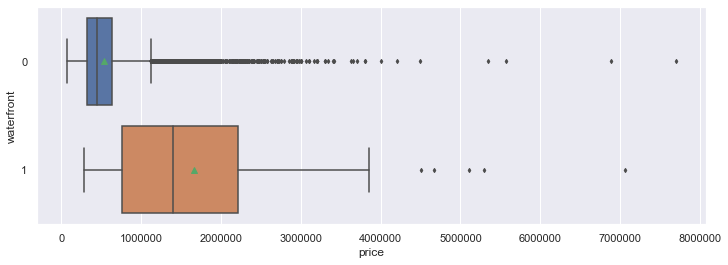

point biserial correlation r is 0.2663694340306021 with p = 0.0


In [18]:
fig, ax = plt.subplots(figsize=(12,4))
sns.boxplot(y = 'waterfront', x = 'price', data = data,width = 0.8,orient = 'h', showmeans = True, fliersize = 3, ax = ax)
plt.show()

# Calculate the correlation coefficient
r, p = stats.pointbiserialr(data['waterfront'], data['price'])
print ('point biserial correlation r is %s with p = %s' %(r,p))

* Корреляция мала (г < 0,3). Обратите внимание, что мы не проверили здесь 3 основных предположения о точечно-бисериальной корреляции и не можем слишком полагаться на результат (1: не должно быть значительных выбросов в двух группах дихотомической переменной с точки зрения непрерывной переменной, 2: должна быть однородность дисперсий, 3: непрерывная переменная должна быть приблизительно нормально распределена для каждой группы дихотомической переменной). 

Мы можем запустить такой же тест для переменной basement_present и того, был ли дом отремонтирован в прошлом.

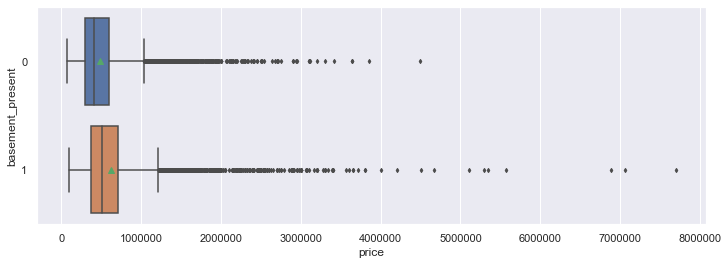

point biserial correlation r between price and basement_present is 0.1802300866502102 with p = 3.256778736238385e-157



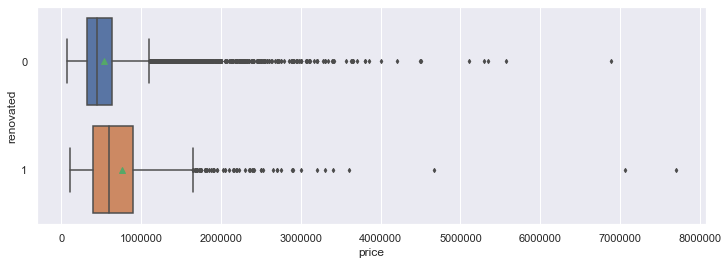

point biserial correlation r between price and renovated is 0.12609226271139487 with p = 2.640148591798377e-77


In [19]:
# Your code here
# basement_present variable

# Your code here
# renovated variable

Корреляции существуют, но они довольно малы (0,1 <r <0,3).

Давайте перейдем к нашим порядковым переменным и оценим их корреляцию с ценой на жилье.

In [ ]:
# TO DO: Построить распределение категорий каждой переменной с помощью boxplots.

Как и ожидалось, все они связаны с ценой дома.

### 1.6. Кодирование категориальных признаков

Фиктивная переменная (Dummy variable) - это искусственная переменная, которая специально создаётся для представления признака с двумя или более различными категориями. В данном примере закодируем следующее:

* floors
* view
* condition
* grade

Фиктивное кодирование относится к процессу кодирования категориальной переменной в дихотомические переменные.
Номинальная переменная не подходит в качестве предиктора в множественной линейной регрессии. Однако эта переменная может быть представлена с использованием серии из нескольких дихотомических переменных (закодированных как 0 или 1).

In [13]:
categorial_cols = ['floors', 'view', 'condition', 'grade']

for cc in categorial_cols:
    dummies = pd.get_dummies(data[cc], drop_first=False)
    dummies = dummies.add_prefix("{}#".format(cc))
    data.drop(cc, axis=1, inplace=True)
    data = data.join(dummies)

Как можно заметить почтовые индексы тоже связаны с ценой. Однако, закодированные почтовые индексы добавят 70 фиктивных переменных. Поэтому мы закодируем только 6 самых дорогих почтовых индексов.

In [13]:
dummies_zipcodes = pd.get_dummies(data['zipcode'], drop_first=False)
dummies_zipcodes.reset_index(inplace=True)
dummies_zipcodes = dummies_zipcodes.add_prefix("{}#".format('zipcode'))
dummies_zipcodes = dummies_zipcodes[['zipcode#98004','zipcode#98102','zipcode#98109','zipcode#98112','zipcode#98039','zipcode#98040']]
data.drop('zipcode', axis=1, inplace=True)
data = data.join(dummies_zipcodes)

data.dtypes

price                float64
bedrooms               int64
bathrooms            float64
sqft_living            int64
sqft_lot               int64
waterfront          category
sqft_above             int64
sqft_basement          int64
yr_built               int64
yr_renovated           int64
lat                  float64
long                 float64
sqft_living15          int64
sqft_lot15             int64
basement_present       int64
renovated              int64
floors#1.0             uint8
floors#1.5             uint8
floors#2.0             uint8
floors#2.5             uint8
floors#3.0             uint8
floors#3.5             uint8
view#0                 uint8
view#1                 uint8
view#2                 uint8
view#3                 uint8
view#4                 uint8
condition#1            uint8
condition#2            uint8
condition#3            uint8
condition#4            uint8
condition#5            uint8
grade#1                uint8
grade#3                uint8
grade#4       

### 1.7. Разбиение выборки

Разделим датасет на обучающую и тестовую выборки: каждая модель будет обучена на обучающей выборке и оценена с помощью отложенной тестовой выборки.

In [28]:
X = # Your code here
y = # Your code here

In [29]:
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=10)

**Вопрос.** *Обучение и тестирование.*\
В чём преимущество разделение датасета на какое-то отношение обучающих и тестовых подмножеств для обучающего алгоритма?\
*Подсказка:* Что может пойти не так, если нет способа протестировать модель?

## 2. Обучение регрессионых моделей

В этой части мы обучим несколько регрессионных моделей на обучающей выборке (простую линейную регрессию, lasso, KNN) и оценим их качество с помощью Root Mean Squared Error (RMSE) на тестовой выборке.

### 2.1. k-Nearest Neighbors (NN) Regression

<img src="http://res.cloudinary.com/dyd911kmh/image/upload/f_auto,q_auto:best/v1531424125/Knn_k1_z96jba.png">

Метод ближайших соседей (k Nearest Neighbors, или kNN) — очень популярный метод классификации, также иногда используемый в задачах регрессии. Это, наравне с деревом решений, один из самых понятных подходов к классификации. На уровне интуиции суть метода такова: посмотри на соседей, какие преобладают, таков и ты. Формально основой метода является гипотеза компактности: если метрика расстояния между примерами введена достаточно удачно, то схожие примеры гораздо чаще лежат в одном классе, чем в разных.

Для классификации каждого из объектов тестовой выборки необходимо последовательно выполнить следующие операции:


* Вычислить расстояние до каждого из объектов обучающей выборки
* Отобрать  объектов обучающей выборки, расстояние до которых минимально
* Класс классифицируемого объекта — это класс, наиболее часто встречающийся среди  ближайших соседей

Под задачу регрессии метод адаптируется довольно легко – на 3 шаге возвращается не метка, а число – среднее (или медианное) значение целевого признака среди соседей.

(https://www.analyticsvidhya.com/blog/2018/03/introduction-k-neighbours-algorithm-clustering/

Качество классификации/регрессии методом ближайших соседей зависит от нескольких параметров:


* число соседей
* метрика расстояния между объектами (часто используются метрика Хэмминга, евклидово расстояние, косинусное расстояние и расстояние Минковского). Отметим, что при использовании большинства метрик значения признаков надо масштабировать. Условно говоря, чтобы признак "Зарплата" с диапазоном значений до 100 тысяч не вносил больший вклад в расстояние, чем "Возраст" со значениями до 100.
* веса соседей (соседи тестового примера могут входить с разными весами, например, чем дальше пример, тем с меньшим коэффициентом учитывается его "голос")

#### Преобразование признаков 

kNN предскажет полную чушь, если признаки ненормированы: одно распределение расположено в районе нуля и не выходит за пределы (-1, 1), а другой признак – это сотни и тысячи.

Простой пример: предположим, что стоит задача предсказать стоимость квартиры по двум признакам – удаленности от центра и количеству комнат. Количество комнат редко превосходит 5, а расстояние от центра в больших городах легко может измеряться в десятках тысяч метров.

Самая простая трансформация – это Standart Scaling (она же Z-score normalization).

In [17]:
input_feature = 'sqft_living'
train_data = X_train[input_feature].as_matrix().reshape(-1, 1)
scaler = preprocessing.StandardScaler().fit(train_data)
train_data_scaled = scaler.transform(train_data)
test_data = X_test[input_feature].as_matrix().reshape(-1, 1)
test_data_scaled = scaler.transform(test_data)

knn = neighbors.KNeighborsRegressor(n_neighbors=10, weights='distance') # initialize the model
knn.fit(train_data_scaled, y_train) # fit the train data
y_pred = knn.predict(test_data_scaled)

#### Метрики качества в задачах регрессии

In [18]:
def calculate_errors(y_test, y_pred):
    rmse = mean_squared_error(y_test, y_pred)**0.5
    r_squared = r2_score(y_test, y_pred)
    mae = np.mean(abs(y_pred - y_test))
    return rmse, r_squared, mae

**Среднеквадратичная ошибка**

$$MSE = \frac{1}{n}\Sigma_{i=1}^{n}{\Big({y_i-\hat{y_i}}\Big)^2}$$

* легко минимизировать
* сильно штрафует за большие ошибки (из-за возведения в квадрат)

**Квадратный корень из среднеквадратичной ошибки**

$$RMSE = \sqrt{\frac{1}{n}\Sigma_{i=1}^{n}{\Big({y_i-\hat{y_i}}\Big)^2}}$$

**Средняя абсолютная ошибка**

$$MAE = \frac{1}{n}\Sigma_{i=1}^{n}{|{y_i-\hat{y_i}}|}$$

* сложнее минимизировать (у модуля производная есть не везде - в нуле она отсутствует)
* выше устойчивость к выбросам

**Коэффициент детерминации**

$$R^2 = 1 - {\frac{MSE(model)}{MSE(baseline)}}$$

* значение можно интерпретировать ($R^2$ - интерпретируемый вариант MSE):

$R^2 = 1$ - идеальная модель

$R^2 = 0$ - модель на уровне константной (выдаёт средний ответ по всей выборке)

$R^2 < 0$ - модель хуже константной

* доля дисперсии, объяснённая моделью, в общей дисперсии ответов, т.е. какую долю разнообразия ответов модель смогла объяснить/предсказать

In [19]:
rmse, r_squared, mae = calculate_errors(y_test, y_pred)
# Создадим датафрейм для сохранения результатов каждой модели
summary_df = pd.DataFrame(index = ['Root Mean Squared Error', 'Mean Absolute Error', 'R-squared'])
summary_df['KNN Regression'] = [rmse, mae, r_squared]
summary_df

,KNN Regression
Root Mean Squared Error,265277.224097
Mean Absolute Error,173366.133223
R-squared,0.429617
Relative Absolute Error,0.746289
Relative Squared Error,0.570383


Число соседей связано со сложностью регрессионной модели. Мы можем оптимизировать точность модели, запустив кросс-валидацию по количеству соседей.

In [20]:
k_range = #...
scores = []

for k in k_range:
    #...

In [11]:
plt.plot(k_range, scores)
plt.xlabel('Value of K for KNN')
plt.ylabel('Testing RMSE')

### 2.2. Простая (одномерная) линейная регрессия

*“Draw the line. Yes, this counts as machine learning.”*

<img src="https://i.vas3k.ru/7rg.jpg">

Регрессия — та же классификация, только вместо категории мы предсказываем число. Стоимость автомобиля по его пробегу, количество пробок по времени суток, объем спроса на товар от роста компании и.т.д. На регрессию идеально ложатся любые задачи, где есть зависимость от времени.

Модель пытается нарисовать линию, которая в среднем отражает зависимость, считая среднее расстояние до каждой точки и пытаясь всем угодить.

Линейная регрессия является параметрическим методом, что означает, что она делает предположение о виде (форме) функции, связывающей X и Y. Наша модель будет функцией, которая предсказывает ŷ с учетом определенного x:

<center>ŷ = β0 + β1x, </center>

где β0 - свободный член, а β1 — коэффициент регрессии, или угловой коэффициент, определяющий наклон линии регрессии по отношению к осям координат.
Наша цель состоит в том, чтобы обучить параметры модели (в данном случае, β0 and β1) таким образом, чтобы минимизировать ошибку в предсказаниях модели.

Сначала предскажем цены домов, используя простую линейную регрессию (т.е. на входе только один признак). 

In [29]:
# A function that take one input of the dataset and return the RMSE (of the test data), and the intercept and coefficient
def simple_linear_model(X_train, y_train, X_test, y_test, input_feature):
    train_data = X_train[input_feature].as_matrix().reshape(-1, 1)
    test_data = X_test[input_feature].as_matrix().reshape(-1, 1)
    
    regr = LinearRegression() 
    regr.fit(train_data, y_train)
    y_pred = regr.predict(test_data)
    
    RMSE = mean_squared_error(y_test, y_pred)**0.5 # Calculate the RMSE on test data
    return RMSE, regr.intercept_, regr.coef_[0]

Создадим простую линейную регрессию, используя для обучения один признак - `sqft_living` и вычислим RMSE на тестовой выборке.

In [10]:
RMSE, w0, w1 = simple_linear_model(X_train, y_train, X_test, y_test, 'sqft_living', plot=True)
print ('RMSE for sqft_living is: %s ' %RMSE)
print ('intercept is: %s' %w0)
print ('coefficient is: %s' %w1)

In [9]:
# Заполним наш датасет с результатами модели
# Your code here

rmse, r_squared, mae = calculate_errors(y_test, y_pred)
summary_df['Simple Linear Regression'] = [rmse, mae, r_squared]
summary_df

Точно также мы можем запустить тот же тест на всех признаках в датасете и выбрать тот, который лучше всех будет предсказывать цену дома, используя простую линейную регрессию.

In [12]:
input_list = data.columns.values.tolist() 
input_list.remove('price')
simple_linear_result = pd.DataFrame(columns = ['feature', 'RMSE', 'intercept', 'coefficient'])

# Your code here
# loop that calculate the RMSE of the test data for each input 


simple_linear_result.sort_values('RMSE').head(10)

В случае, когда используем простую линейную регрессию, `sqft_living` обеспечивает наименьшую ошибку для предсказанания цены дома на тестовой выборке для данного датасета.

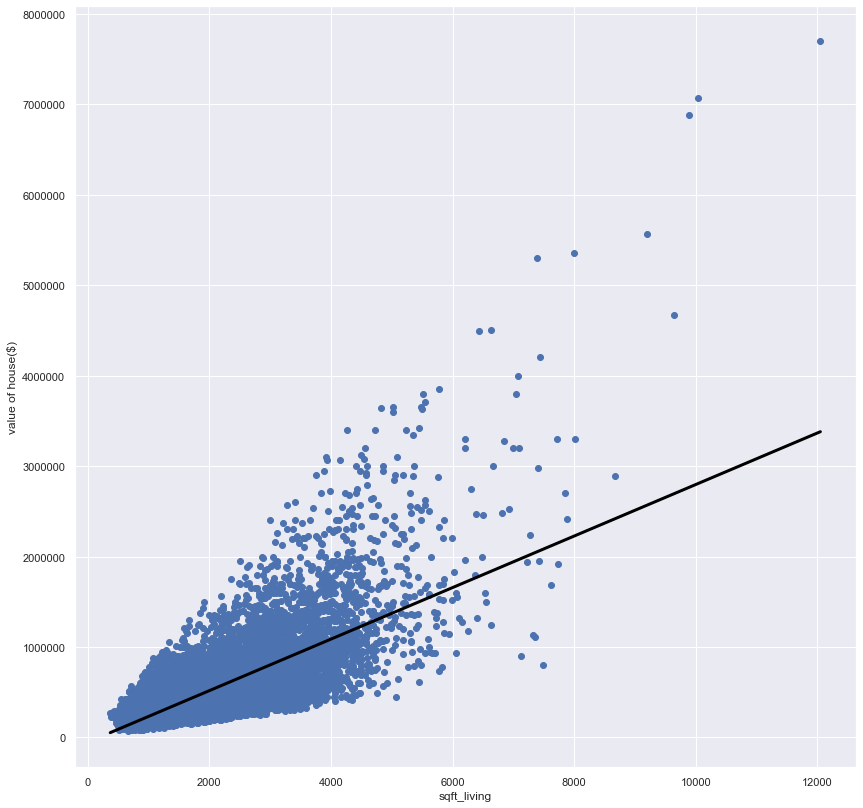

In [33]:
regr = LinearRegression()
regr.fit(X_train['sqft_living'].as_matrix().reshape(-1, 1), y_train)

prediction_space = np.linspace(min(X_train['sqft_living'].as_matrix()), max(X_train['sqft_living'].as_matrix())).reshape(-1,1) 
plt.scatter(X_train['sqft_living'].as_matrix(), y_train)
plt.plot(prediction_space, regr.predict(prediction_space), color = 'black', linewidth = 3)
plt.ylabel('value of house($)')
plt.xlabel('sqft_living')
plt.show()

### 2.3. Множественная линейная регрессия

А теперь попробуем предсказать цену, используя несколько признаков. Мы можем модифицировать функцию простой линейной регрессии выше, подавая на вход несколько признаков.

In [34]:
def multiple_regression_model(X_train, y_train, X_test, y_test, input_features):
    ################################################################################
    # TODO: Implement multiple regression                                          #
    ################################################################################
    pass
    return RMSE, regr.intercept_, regr.coef_ 

Попробуем перебрать несколько вариантов:

In [35]:
print ('RMSE: %s, intercept: %s, coefficients: %s' %multiple_regression_model(X_train, y_train, X_test, y_test, 
                                                                              ['sqft_living','bathrooms','bedrooms']))
print ('RMSE: %s, intercept: %s, coefficients: %s' %multiple_regression_model(X_train, y_train, X_test, y_test,
                                                                              ['sqft_above','view#0','bathrooms']))
print ('RMSE: %s, intercept: %s, coefficients: %s' %multiple_regression_model(X_train, y_train, X_test, y_test, 
                                                                              ['bathrooms','bedrooms']))
print ('RMSE: %s, intercept: %s, coefficients: %s' %multiple_regression_model(X_train, y_train, X_test, y_test, 
                                                                              ['view#0','grade#12','bedrooms','sqft_basement']))
print ('RMSE: %s, intercept: %s, coefficients: %s' %multiple_regression_model(X_train, y_train, X_test, y_test, 
                                                                              ['sqft_living','bathrooms','view#0']))

RMSE: 250187.92234957777, intercept: 71710.07635449525, coefficients: [   316.33906438   4471.42946721 -58843.06358983]
RMSE: 258989.58826181976, intercept: 301480.55488042824, coefficients: [ 2.00780121e+02 -3.26299265e+05  8.24565262e+04]
RMSE: 297927.58055662044, intercept: -30217.46570517635, coefficients: [240763.15920833  18133.91762175]
RMSE: 296472.03754808905, intercept: 511725.2685359201, coefficients: [-3.42460135e+05  1.41466934e+06  8.61730480e+04  1.40486831e+02]
RMSE: 244403.62901958986, intercept: 195354.2458437599, coefficients: [    266.66964211   -2658.219887   -225873.71178985]


Мы также можем попробовать обучить полином высокого порядка. Например, мы можем попробовать обучить квадратичную функцию на `sqft_living`.

In [36]:
# TODO: Create a new column in train_data and in test_data
# X_train['sqft_living_squared'] = 
# X_test['sqft_living_squared'] = 
print ('RMSE: %s, intercept: %s, coefficients: %s' %multiple_regression_model(X_train, y_train, 
                                                                              X_test, y_test, 
                                                                              ['sqft_living','sqft_living_squared']))

RMSE: 269580.40986437874, intercept: 261660.4928094272, coefficients: [8.13559053 0.05065737]


Несмотря на то, что мы добились лучшего качества по сравнению с простой линейной регрессией, всё ещё остается несколько проблем.

*Во-первых*, мы не знаем, какой признак выбрать. Очевидно, что некоторые комбинации признаков приведут к меньшей RMSE на тестовой выборке.\
*Во-вторых*, мы не знаем, сколько признаков нам нужно взять. Это связано с тем, что чем больше признаков мы включим в обучение модели, тем больше мы переобучимся на данных из обучающей выборки, что приведёт к более высокой ошибке на тестовой выборке.\
Одним из решений было бы протестировать несколько комбинаций признаков (все?) и оставить решение с наименьшим значением ошибки, рассчитанным на тестовой выборке. Однако это слишком оптимистичный подход, поскольку сложность модели выбирается для минимизации ошибки на тестовой выборке (ошибка смещена). Более сложный подход заключается в использовании двух наборов для тестирования наших моделей: валидационной выборки и тестовой выборки. Мы выбираем сложность модели, чтобы минимизировать ошибку на валидационной выборке и аппроксимировать ошибку обобщения на тестовой выборке.

Перебор всех подмножеств комбинаций признаков чаще всего вычислительно неосуществим. Например, 30 признаков дает более 1 миллиарда комбинаций. Другой подход заключается в использовании жадного алгоритма для отбора признаков, например такой как пошаговый прямой отбор, в котором мы начинаем с пустого набора признаков, а затем итеративно добавляем признаки, обеспечивающие наилучший прирост качества модели. Например, давайте представим, что наилучший признак - это `sqft_living`. На втором шаге жадного алгоритма, мы тестируем все оставшиеся признаки один за другим в комбинации с `sqft_living` (например, `sqft_living` и `bedrooms`, `sqft_living` и `waterfront`, и т.п.) и выбираем наилучшую комбинацию, исходя из ошибки на обучающей выборке. В конце, мы выбираем сложность модели (кол-во признаков) на основе валидационной ошибки и оцениваем погрешность обобщения с помощью ошибки на тестовой выборке.

Давайте попробуем такой метод.

In [37]:
# we're first going to add more features into the dataset.

# sqft_living cubed
#X_train['sqft_living_cubed'] = 
#X_test['sqft_living_cubed'] =

# bedrooms_squared: this feature will mostly affect houses with many bedrooms.
#X_train['bedrooms_squared'] =
#X_test['bedrooms_squared'] =

# bedrooms times bathrooms gives what's called an "interaction" feature. It is large when both of them are large.
#X_train['bed_bath_rooms'] =
#X_test['bed_bath_rooms'] =

# Taking the log of squarefeet has the effect of bringing large values closer together and spreading out small values.
#X_train['log_sqft_living'] =
#X_test['log_sqft_living'] =


In [38]:
# split the train_data to include a validation set (train_data2 = 60%, validation_data = 20%, test_data = 20%)
train_data, validation_data, train_y, val_y = train_test_split(X_train, y_train, train_size = 0.75, random_state = 50)

In [39]:
# A function that take multiple features as input and return the RMSE (of the train and validation data)
def RMSE(train_data, validation_data, train_y, val_y, features, new_input):
    features_list = list(features)
    features_list.append(new_input)
    regr = LinearRegression() # Create a linear regression object
    regr.fit(train_data[features_list].as_matrix(), train_y) # Train the model
    RMSE_train = mean_squared_error(train_y, 
                              regr.predict(train_data[features_list].as_matrix()))**0.5 # Calculate the RMSE on train data
    RMSE_validation = mean_squared_error(val_y, 
                              regr.predict(validation_data[features_list].as_matrix()))**0.5 # Calculate the RMSE on train data
    return RMSE_train, RMSE_validation 

In [13]:
input_list = train_data.columns.values.tolist() # list of column name

# list of features included in the regression model and the calculated train and validation errors (RMSE)
regression_greedy_algorithm = pd.DataFrame(columns = ['feature', 'train_error', 'validation_error'])  
i = 0

# a while loop going through all the features in the dataframe
while i < len(train_data.columns)-1:
    
    # a temporary dataframe to select the best feature at each iteration
    temp = pd.DataFrame(columns = ['feature', 'train_error', 'validation_error'])
    
    # a for loop to test all the remaining features
    for p in input_list:
       # TO DO: implement greedy algorithm
regression_greedy_algorithm

Мы видим, что ошибка на валидационной выборке минимальна, когда мы достигаем 29 признаков в модели (condition#4). Мы останавливаем свой выбор здесь, даже если ошибка на обучающей выборке продолжает уменьшаться (переобучение).

Теперь оценим погрешность обобщения, используя тестовую выборку

In [42]:
greedy_algo_features_list = regression_greedy_algorithm['feature'].tolist()[:29]
train_data = train_data[greedy_algo_features_list]
test_data = X_test[greedy_algo_features_list]

regr = LinearRegression()
regr.fit(train_data, train_y)
y_pred = regr.predict(test_data)

rmse, r_squared, mae = calculate_errors(y_test, y_pred)
summary_df['Multiple Linear Regression'] = [rmse, mae, r_squared]
summary_df

,KNN Regression,Gradient Boosted Machine Regression,XGBRegressor,Simple Linear Regression,Multiple Linear Regression
Root Mean Squared Error,265277.224097,134218.204682,132072.557628,252870.779142,205986.425996
Mean Absolute Error,173366.133223,78835.764349,78915.348485,173143.072938,118772.754483
R-squared,0.429617,0.853988,0.858619,0.481721,0.656091
Relative Absolute Error,0.746289,0.339364,0.339707,0.745329,0.511281
Relative Squared Error,0.570383,0.146012,0.141381,0.518279,0.343909


Ошибка на тестовой выборке стала меньше.

Замечание 1: Мы могли бы использовать k-кратную кросс-валидацию вместо валидационной выборки.\
Замечание 2: Существуют и другие жадные алгоритмы (например, обратный отбор, объединение прямого и обратного).
Теперь вместо поиска в дискретном наборе решений с использованием жадных алгоритмов мы можем воспользоваться другим методом, называемым **регуляризацией**. Мы начнём со всех возможных признаков в модели и будем сокращать коэффициенты (веса). Существует два самых популярных метода для регуляризации, каждый из которых нацелен на уменьшение размера коэффициентов: Ridge Regression штрафует сумму квадратов коэффициентов (L2-регуляризация), а Lasso Regression штрафует сумму абсолютных значений коэффициентов (L1-регуляризация).

## 3. Переобучение

Регуляризация — это метод для уменьшения степени переобучения модели, а значит, прежде чем мы разберемся, что такое регуляризация, нужно понять суть переобучения (overfitting). 

Переобучение дает неплавные кривые прогнозирования, т. е. «нерегулярные». Такие плохие сложные кривые прогнозирования обычно характеризуются весовыми значениями, которые имеют очень большие или очень малые величины. Поэтому один из способов уменьшить степень переобучения состоит в том, чтобы не допускать очень малых или больших весовых значений для модели. В этом и заключается суть регуляризации.

<img src="https://habrastorage.org/web/ad8/366/a44/ad8366a4469346c6b2e1306495b05d1a.jpg" width="400" height="200">

## 4. Регуляризация

**Overfitting:** “Sherlock, your explanation of what just happened is too specific to the situation.” 

**Regularization:** “Don’t overcomplicate things, Sherlock. I’ll punch you for every extra word.” 

**Hyperparameter (λ):** “Here’s the strength with which I will punch you for every extra word.”

Регуляризация — это способ уменьшить сложность модели чтобы предотвратить переобучение или исправить некорректно поставленную задачу. Обычно это достигается добавлением некоторой априорной информации к условию задачи.

В данном случае суть регуляризации состит в том, что мы создаём модель со всеми предикторами, а потом искуственно уменьшаем размер коэффициентов, прибавляя некоторую величину к ошибке.

Ошибка — это то, что минимизируется обучением с помощью одного из примерно десятка численных методов вроде градиентного спуска (gradient descent), итерационного алгоритма Ньютона-Рафсона (iterative Newton-Raphson), L-BFGS, обратного распространения ошибок (back-propagation) и оптимизации роя (swarm optimization).

Чтобы величины весовых значений модели не становились большими, процесс регуляризации штрафует весовые значения добавляя их в вычисление ошибки. Если весовые значения включаются в общую ошибку, которая минимизируется, тогда меньшие весовые значения будут давать меньшие значения ошибки. L1-регуляризация штрафует весовые значения добавлением суммы их абсолютных значений к ошибке.

L2-регуляризация выполняет аналогичную операцию добавлением суммы их квадратов к ошибке.

### 4.1. Ridge Regression

Ридж-регрессия или гребневая регрессия (ridge regression) - это один из методов понижения размерности. Часто его применяют для борьбы с переизбыточностью данных, когда независимые переменные коррелируют друг с другом (т.е. имеет место мультиколлинеарность).

Когда мы делаем линейную регрессию, то функция потерь выглядит так:

$$\mathcal{L}\left(X, \vec{y}, \vec{w} \right) = \frac{1}{2n} \sum_{i=1}^n \left(\vec{x_i}^T \vec{w} - y_i\right)^2$$

Теперь в ридж-регрессии мы добавляем к ней $\lambda\sum_{j=1}^m \left| w_j \right|$, где $\lambda$ обозначает размер штрафа. Если $\lambda = 0$, то это обычная линейная регрессия.

* Чем меньше $\lambda$, тем выше дисперсия и ниже смещение.

* Чем больше $\lambda$, тем ниже дисперсия и выше смещение.

Взяв производную от этой функции, мы получим формулу, которая не имеет аналитического решения, т.е. МНК не подходит. Следовательно, необходимо использовать градиентный спуск.

Протестируем две модели, где возьмём параметр $\lambda$ равный 1 и 10.

In [43]:
input_feature = train_data.columns.values.tolist()

for i in [1,10]:
    ridge = Ridge(alpha = i, normalize = True)
    ridge.fit(X_train[input_feature], y_train)
    print ('test error (RMSE) is: %s' %mean_squared_error(y_test, 
                              ridge.predict(X_test[input_feature]))**0.5) # predict price and test error

test error (RMSE) is: 215856.58176845187
test error (RMSE) is: 287518.08725462167


Вопрос теперь в том, как нам выбрать $\lambda$, чтобы минимизировать ошибку?

$\lambda$ измеряет сложность модели. Т.е., как и ранее, мы могли бы использовать валидационную выборку, чтобы подобраь этот параметр. Однако такой подход имеет существенный недостаток: он оставляет меньше примеров для обучения. Лучшим подходом для преодоления этой проблемы является использование метода кросс-валидации. Он по-умному использует всю обучающую выборку. Например, k-кратная кросс-валидация включает в себя разделение обучающей выборки на k сегментов примерно одинакового размера. Подобно методу с валидационной выборкой, мы измеряем ошибку валидации с помощью одного из сегментов, обозначенного как валидационная выборка. Основное отличие состоит в том, что мы повторяем процесс k раз. Затем мы вычисляем среднее значение k ошибок на валидационной выборке и используем его в качестве оценки ошибки обобщения. Затем мы выбираем значение $\lambda$, которое генерирует наименьшую валидационную ошибку. Наилучшее приближение имеет место для валидационных выборок размера 1, где k равно количеству примеров в выборке. Это называется Leave-One-Out кросс-валидацией. Однако, это вычислительно затратно.

В этом примере мы будем использовать ридж-регрессию с кросс-валидацией из библиотеки scikit-learn. По умолчанию, выполняется обобщенная кросс-валидация (Generalized Cross-Validation), которая является одной из форм эффективной Leave-One-Out кросс-валидации.

In [17]:
# Your code here (найти лучшее значение 𝜆)

Используя каждый признак в датасете и ридж-регрессию с эффективной LOO кросс-валидацией, получаем ошибку на тестовой выборке - 211231.

In [45]:
rmse, r_squared, mae = calculate_errors(y_test, y_pred)
summary_df['Ridge Regression'] = [rmse, mae, r_squared]
summary_df

,KNN Regression,Gradient Boosted Machine Regression,XGBRegressor,Simple Linear Regression,Multiple Linear Regression,Ridge Regression
Root Mean Squared Error,265277.224097,134218.204682,132072.557628,252870.779142,205986.425996,215301.815265
Mean Absolute Error,173366.133223,78835.764349,78915.348485,173143.072938,118772.754483,119078.755909
R-squared,0.429617,0.853988,0.858619,0.481721,0.656091,0.624282
Relative Absolute Error,0.746289,0.339364,0.339707,0.745329,0.511281,0.512598
Relative Squared Error,0.570383,0.146012,0.141381,0.518279,0.343909,0.375718


### 4.2. Lasso Regression (Least absolute shrinkage and selection operator)

Очень похожа на ридж регрессию. В ней штраф — это сумма модулей значений коэффициентов. Основное различие лассо- и ридж-регрессии заключается в том, что первая может приводить к обращению некоторых независимых переменных в ноль, тогда как вторая уменьшает их до значений, близких к нулю.

Обучим несколько моделей, используя разные значения $\lambda$, и получим ошибки на тестовой выборке.

In [14]:
for i in [0.01,0.1,1,250,500,1000]:
    # Your code here

Когда $\lambda$ возрастает, кол-во признаков в модели уменьшается. Как и в ридж-регрессии, мы тоже можем использовать методы кросс-валидации для выбора наилучшего $\lambda$, чтобы обеспечить наилучшую предиктивную точность. Однако этот метод имеет тенденцию отдавать предпочтение менее разреженным решениям и меньшей $\lambda$, чем оптимальному выбору для отбора признаков.

In [16]:
# Your code here (найти лучшее значение 𝜆)

In [48]:
rmse, r_squared, mae = calculate_errors(y_test, y_pred)
summary_df['Lasso Regression'] = [rmse, mae, r_squared]
summary_df

,KNN Regression,Gradient Boosted Machine Regression,XGBRegressor,Simple Linear Regression,Multiple Linear Regression,Ridge Regression,Lasso Regression
Root Mean Squared Error,265277.224097,134218.204682,132072.557628,252870.779142,205986.425996,215301.815265,215375.134359
Mean Absolute Error,173366.133223,78835.764349,78915.348485,173143.072938,118772.754483,119078.755909,119404.528912
R-squared,0.429617,0.853988,0.858619,0.481721,0.656091,0.624282,0.624026
Relative Absolute Error,0.746289,0.339364,0.339707,0.745329,0.511281,0.512598,0.514001
Relative Squared Error,0.570383,0.146012,0.141381,0.518279,0.343909,0.375718,0.375974


В модели осталось 39 признаков, что привело к ошибке на тестовой выборке - 216455.

## 5. Ансамбли. Градиентный бустинг

**Стекинг.** Обучаем несколько разных алгоритмов и передаём их результаты на вход последнему, который принимает итоговое решение.

**Беггинг.** Обучаем один алгоритм много раз на случайных выборках из исходных данных. В самом конце усредняем ответы.

**Бустинг.** Обучаем алгоритмы последовательно, каждый следующий уделяет особое внимание тем случаям, на которых ошибся предыдущий.

Как в беггинге, мы делаем выборки из исходных данных, но теперь не совсем случайно. В каждую новую выборку мы берём часть тех данных, на которых предыдущий алгоритм отработал неправильно. То есть как бы доучиваем новый алгоритм на ошибках предыдущего.

Реальный пример работы бустинга — откройте Яндекс и введите запрос.

<img src="https://lambda-it.ru/media/editor/bos_20190327103839388149.jpg">

Одна из причин популярности деревьев решений и всех производных алгоритмов (случайный лес, градиентный бустинг) – не все умеют/хотят возиться с преобразованиями, а эти алгоритмы устойчивы к необычным распределениям.

Прежде чем обучать модель градиентного бустинга, нам нужно подобрать для неё наилучшие параметры. Мы сделаем это с помощью кросс-валидации вместе с grid search'ом.

In [ ]:
tuned_params = # TO DO: перебрать комбинации значений параметров
gscv = GridSearchCV(GradientBoostingRegressor(loss = 'ls', random_state=0), 
                    tuned_params, cv=5, scoring='neg_mean_squared_error')

start = time()
gscv.fit(X_train.as_matrix(), y_train)

print('The grid cross validation lasted {:0.1f} seconds'.format(time() - start))
print('Best parameters set found on development set:\n\t{}'.format(
        ', '.join(['{}: {}'.format(i,j) for i,j in gscv.best_params_.items()])))
print('Grid scores on development set:')
print(gscv.cv_results_)

Обучим GBM модель с параметрами, которые дают наилучшее качество:

In [ ]:
#params = gscv.best_params_
#gbm = GradientBoostingRegressor(**params)
gbm = GradientBoostingRegressor(loss='ls', random_state=123)

# TO DO: обучить GradientBoosting model

График ниже отображает важность признаков:

In [ ]:
feature_importance = gbm.feature_importances_
feature_importance = 100.0 * (feature_importance / feature_importance.max())
sorted_idx = np.argsort(feature_importance)[::-1]
sorted_idx = sorted_idx[:15]

sns.set_style("darkgrid")
plt.figure(figsize=(18, 10))
index = np.arange(len(X_train.columns[:15]))
bar_width = 0.1
plt.bar(index, feature_importance[sorted_idx], color='black', alpha=0.5)
plt.xlabel('features')
plt.ylabel('importance')
plt.title('Feature importance')
plt.xticks(index + bar_width, np.array(X_train.columns)[sorted_idx])
plt.tight_layout()
plt.show()

Давайте оценим, может ли качество нашей GBM модели быть ограничена количеством используемых оценщиков (estimator):

In [ ]:
# отобразим аномальность для обучающей и тестовой выборок
test_score = np.zeros(params['n_estimators'])
for j, y_pred in enumerate(gbm.staged_predict(X_test.as_matrix())):
    test_score[j] = gbm.loss_(y_test, y_pred)

sns.set_style("darkgrid")
plt.figure(figsize=(10, 6))
plt.title('Deviance')
plt.plot(np.arange(params['n_estimators']) + 1, gbm.train_score_, 'b-',
         label='Training Set Deviance')
plt.plot(np.arange(params['n_estimators']) + 1, test_score, 'r-',
         label='Test Set Deviance')
plt.legend(loc='upper right')
plt.xlabel('Number of estimators')
plt.ylabel('Deviance')

График выше демонстрирует, что функция потерь выходит на плато задолго до того, как мы достигнем заданного числа оценщиков, используемых нашей моделью. Скорее всего, мы сможем обойтись и меньшим количеством оценщиков в угоду скорости.

Теперь можем проверить качество модели на тестовой выборке:

In [ ]:
rmse, r_squared, mae = calculate_errors(y_test, y_pred)
summary_df['Gradient Boosted Machine Regression'] = [rmse, mae, r_squared]
summary_df

### 5.1. XGBoost

<img src="https://i.imgur.com/e7MIgXk.png">

Прелесть [этого мощного алгоритма](https://www.analyticsvidhya.com/blog/2018/09/an-end-to-end-guide-to-understand-the-math-behind-xgboost/) заключается в его масштабируемости, которая обеспечивает быстрое обучение посредством параллельных и распределенных вычислений и обеспечивает эффективное использование памяти.


In [ ]:
xg_model = xgb.XGBRegressor()
xg_model = xg_model.fit(X_train.as_matrix(),y_train)
y_pred = xg_model.predict(X_test.as_matrix())

In [ ]:
rmse, r_squared, mae = calculate_errors(y_test, y_pred)
summary_df['XGBRegressor'] = [rmse, mae, r_squared]
summary_df

Сегодня есть три популярных метода бустинга, отличия которых хорошо донесены в статье [CatBoost vs. LightGBM vs. XGBoost](https://towardsdatascience.com/catboost-vs-light-gbm-vs-xgboost-5f93620723db)

## Заключение

В этом notebook'е мы попытались разобраться в регрессионных методах, используя датасет о продаже домов. Конечно же, существует множество других методов для решения задач регрессии (например, Elastic Net, kernel regression, Bayesian regression). Однако выбор модели зависит от особенностей данных и контекста применения.

**Вопрос.** *Контекст применения.*\
Можно ли использовать построенную модель в реальных условиях?\
*Подсказки:*\
Насколько актуальны сегодня данные, собранные в 2014 году?\
Достаточно ли признаков, представленных в датасете, для описания дома?\
Достаточно ли надежна модель?\
Будут ли данные, собранные в таком городе, как Сиэтл, применимы к сельскому поселению?